In [131]:
#################################################################################
# Author: Paulina Arregocés Guerra
# Research groups 
# GITA (Applied Telecommunications Research Group)  - Universidad de Antioquia 
# GIDIA (Artificial Intelligence Research Group) - Universidad Nacional de Colombia
#
# Last modified on 30/05/2023 
# Desciotion: This code is used to label the dataset and to train and test the decision # tree and support vector machine models with real data. 
#################################################################################

' Author: Paulina Arregocés \n    Ultima actualización: 02 de noviembre de 2022\n\n    Observaciones: Se realiza la comparación del modelo Sigmoide para continuar con el resto de comparaciones\n'

In [ ]:
# Select your preferences and run the install command...https://pytorch.org/
#!pip3 install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cpu

# Uncomment for requirement libraries versions
#!pip install -r requirements.txt 

# Comparison Models for BNN's

## Libraries

In [1]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn 
from torch.utils.data import Dataset 
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data.sampler import WeightedRandomSampler

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MaxAbsScaler, StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from random import random

import matplotlib.pyplot as plt

import pickle

print('Libraries fully imported')

Libraries fully imported


### Set Train, Validation and Test Data

In [2]:

def transform_data(target_train,target_val,target_test,input_train,input_val,input_test):
    #Labels training, validation and test
    label_train =torch.from_numpy(np.loadtxt(target_train, dtype=int)) 
    label_val =torch.from_numpy(np.loadtxt(target_val, dtype=int)) 
    label_test =torch.from_numpy(np.loadtxt(target_test, dtype=int)) 
    # Input training, validation and test
    input_train =torch.torch.Tensor(np.loadtxt(input_train, dtype=int)) 
    input_val =torch.torch.Tensor(np.loadtxt(input_val, dtype=int)) 
    input_test =torch.torch.Tensor(np.loadtxt(input_test, dtype=int)) 
    train = torch.utils.data.TensorDataset(input_train, label_train) 
    val = torch.utils.data.TensorDataset(input_val, label_val)
    test = torch.utils.data.TensorDataset(input_test, label_test)
        
    return train, val, test

In [3]:
# Decoded Data
trainNN, valNN ,testNN= transform_data('./CSV_TXT/target_train.txt', './CSV_TXT/target_val.txt', './CSV_TXT/target_test.txt','./CSV_TXT/features_train.txt', './CSV_TXT/features_val.txt', './CSV_TXT/features_test.txt')
# Binary Data
train_Bin,val_Bin ,test_Bin= transform_data('./CSV_TXT/target_train_Bin.txt', './CSV_TXT/target_val_Bin.txt', './CSV_TXT/target_test_Bin.txt', './CSV_TXT/features_train_Bin.txt', './CSV_TXT/features_val_Bin.txt', './CSV_TXT/features_test_Bin.txt')    

## Artificial Neural Networks Models

### Architecture models

In [4]:
# Sigmoid 
class NetSigmoid(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetSigmoid, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.sigmoid(self.layer1(x)) 
        x2 = torch.sigmoid(self.layer2(x1))
        return x2 

# Instantiate the model 
model_Sigmoid = NetSigmoid(104, 1) 

In [5]:
# Relu
class NetRelu(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetRelu, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = F.relu(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_Relu = NetRelu(104, 1) 

In [6]:
# Tanh
class NetTanh(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetTanh, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.tanh(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_tanh = NetTanh(104, 1) 

In [7]:
# Run to define Binary Neural Network

class BinaryNeuralNetwork(nn.Module):
    
    def __init__(self, Weights_L1, Weights_L2):
        super(BinaryNeuralNetwork, self).__init__()
        #Weights obteined from NN's control plane 
        self.synaptic_weights_lay1 = Weights_L1.T
        self.synaptic_weights_lay2 = Weights_L2.T

    def sign(self, x):
        #applying the sign function
        z= []
        for i in range(len(x)):
            if (x[i] > 0).any() : z.append(1)
            if (x[i] <= 0).any(): z.append(-1)
        return np.array(z)


    def forward(self, inputs):
        #passing the inputs via the neuron to get output   
        results=[]
        for i in inputs:
            print(inputs,i)
            output1 = self.sign(np.dot(i, self.synaptic_weights_lay1))
            output2 = self.sign(np.dot(output1, self.synaptic_weights_lay2))
            results.append(output2)
            
        return torch.Tensor(list(results)) 

In [8]:
# Get all predictions function

def get_all_preds(model, loader):
    all_preds = torch.tensor([])
    all_labels = torch.tensor([])
    c=0
    for batch in loader:
        c=c+1
        if c>=100: break
        data, labels = batch
        preds = model(data.view(-1,104))
        all_preds = torch.cat(
            (all_preds, preds)
            ,dim=0
        )
        all_labels= torch.cat(
            (all_labels,labels)
            ,dim=0
        )
        
    return all_preds, all_labels

### Model's Comparation 

In [9]:
def Cargar_Modelos(path,arch):
    path=path
    model_arch=arch
    model_arch.load_state_dict(torch.load(path))
    
    return model_arch.eval()

In [11]:
# Sigmoid Models 
Model_Sigmoid_1= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid1.pth',arch=model_Sigmoid)
Model_Sigmoid_2= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid2.pth',arch=model_Sigmoid)
Model_Sigmoid_3= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid3.pth',arch=model_Sigmoid)
Model_Sigmoid_4= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid4.pth',arch=model_Sigmoid)
Model_Sigmoid_5= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid7.pth',arch=model_Sigmoid)
Model_Sigmoid_6= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid11.pth',arch=model_Sigmoid)
Model_Sigmoid_7= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid12.pth',arch=model_Sigmoid)
Model_Sigmoid_8= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid13.pth',arch=model_Sigmoid)
Model_Sigmoid_9= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid14.pth',arch=model_Sigmoid)
Model_Sigmoid_10= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid15.pth',arch=model_Sigmoid)
Model_Sigmoid_11= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid16.pth',arch=model_Sigmoid)
Model_Sigmoid_12= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid17.pth',arch=model_Sigmoid)
Model_Sigmoid_13= Cargar_Modelos(path='./MODELS/Sigmoid/model_Sigmoid18.pth',arch=model_Sigmoid)

In [12]:
# ReLU Models 
Model_RelU_1= Cargar_Modelos(path='./MODELS/ReLU/model_RelU1.pth',arch=model_Relu)
Model_RelU_2= Cargar_Modelos(path='./MODELS/ReLU/model_RelU3.pth',arch=model_Relu)
Model_RelU_3= Cargar_Modelos(path='./MODELS/ReLU/model_RelU4.pth',arch=model_Relu)
Model_RelU_4= Cargar_Modelos(path='./MODELS/ReLU/model_RelU7.pth',arch=model_Relu)
Model_RelU_5= Cargar_Modelos(path='./MODELS/ReLU/model_RelU11.pth',arch=model_Relu)
Model_RelU_6= Cargar_Modelos(path='./MODELS/ReLU/model_RelU12.pth',arch=model_Relu)
Model_RelU_7= Cargar_Modelos(path='./MODELS/ReLU/model_RelU13.pth',arch=model_Relu)
Model_RelU_8= Cargar_Modelos(path='./MODELS/ReLU/model_RelU14.pth',arch=model_Relu)
Model_RelU_9= Cargar_Modelos(path='./MODELS/ReLU/model_RelU15.pth',arch=model_Relu)
Model_RelU_10= Cargar_Modelos(path='./MODELS/ReLU/model_RelU16.pth',arch=model_Relu)
Model_RelU_11= Cargar_Modelos(path='./MODELS/ReLU/model_RelU17.pth',arch=model_Relu)
Model_RelU_12= Cargar_Modelos(path='./MODELS/ReLU/model_RelU18.pth',arch=model_Relu)

In [14]:
# Tanh Models 
Model_Tanh_1= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh1.pth',arch=model_tanh)
Model_Tanh_2= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh3.pth',arch=model_tanh)
Model_Tanh_3= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh4.pth',arch=model_tanh)
Model_Tanh_4= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh7.pth',arch=model_tanh)
Model_Tanh_5= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh11.pth',arch=model_tanh)
Model_Tanh_6= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh12.pth',arch=model_tanh)
Model_Tanh_7= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh13.pth',arch=model_tanh)
Model_Tanh_8= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh14.pth',arch=model_tanh)
Model_Tanh_9= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh15.pth',arch=model_tanh)
Model_Tanh_10= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh16.pth',arch=model_tanh)
Model_Tanh_11= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh17.pth',arch=model_tanh)
Model_Tanh_12= Cargar_Modelos(path='./MODELS/Tanh/model_Tanh18.pth',arch=model_tanh)

In [15]:
# Run to define functions for extracting and binarizing weights.

def Binarize(tensor,quant_mode='det'):
    if quant_mode=='det':
        return tensor.sign()
    
def weigths2(model_arch):
    try:
        trained_weights_lay1 = model_arch.layer1.weight
        trained_weights_lay2 = model_arch.layer2.weight
        Weight_lay1_Bin=Binarize(trained_weights_lay1)
        Weight_lay2_Bin=Binarize(trained_weights_lay2)
        return Weight_lay1_Bin, Weight_lay2_Bin
    except:
        print('No valid Model')


In [16]:
def Metrics(nombre, y_test_true,y_test_pred):

  model_metrics=[]
  model_metrics.append(nombre)

  tn, fp, fn, tp = confusion_matrix(y_true=y_test_true, y_pred=y_test_pred).ravel()

  Accuracy = (tp + tn) / (tp + tn + fp + fn)
  model_metrics.append(Accuracy)

  Precision =  tp / (tp + fp)
  model_metrics.append(Precision)

  Recall = tp / (tp + fn)
  model_metrics.append(Recall)

  f1_score = 2*(Precision*Recall)/(Precision+Recall)
  model_metrics.append(f1_score)

  Error_rate = (fp + fn) / (tp + tn + fp + fn)
  model_metrics.append(Error_rate)

  Specifity = tn / (tn + fp)
  model_metrics.append(Specifity)

  False_negative_rate= fn / (tp + fn)
  model_metrics.append(False_negative_rate)

  False_positive_rate= fp / (tn + fp)
  model_metrics.append(False_positive_rate)

  with open(nombre, "wb") as f:
    pickle.dump(model_metrics, f)

  return model_metrics

#### Sigmoid Model's Comparations

In [17]:
# Define weights for Sigmoid Function
L1_sig1,L2_sig1=weigths2(Model_Sigmoid_1)
L1_sig2,L2_sig2=weigths2(Model_Sigmoid_2)
L1_sig3,L2_sig3=weigths2(Model_Sigmoid_3)
L1_sig4,L2_sig4=weigths2(Model_Sigmoid_4)
L1_sig5,L2_sig5=weigths2(Model_Sigmoid_5)
L1_sig6,L2_sig6=weigths2(Model_Sigmoid_6)
L1_sig7,L2_sig7=weigths2(Model_Sigmoid_7)
L1_sig8,L2_sig8=weigths2(Model_Sigmoid_8)
L1_sig9,L2_sig9=weigths2(Model_Sigmoid_9)
L1_sig10,L2_sig10=weigths2(Model_Sigmoid_10)
L1_sig11,L2_sig11=weigths2(Model_Sigmoid_11)
L1_sig12,L2_sig12=weigths2(Model_Sigmoid_12)
L1_sig13,L2_sig13=weigths2(Model_Sigmoid_13)

binary_sigmoid1 = BinaryNeuralNetwork(L1_sig1,L2_sig1)
binary_sigmoid2 = BinaryNeuralNetwork(L1_sig2,L2_sig2)
binary_sigmoid3 = BinaryNeuralNetwork(L1_sig3,L2_sig3)
binary_sigmoid4 = BinaryNeuralNetwork(L1_sig4,L2_sig4)
binary_sigmoid5 = BinaryNeuralNetwork(L1_sig5,L2_sig5)
binary_sigmoid6 = BinaryNeuralNetwork(L1_sig6,L2_sig6)
binary_sigmoid7 = BinaryNeuralNetwork(L1_sig7,L2_sig7)
binary_sigmoid8 = BinaryNeuralNetwork(L1_sig8,L2_sig8)
binary_sigmoid9 = BinaryNeuralNetwork(L1_sig9,L2_sig9)
binary_sigmoid10 = BinaryNeuralNetwork(L1_sig10,L2_sig10)
binary_sigmoid11 = BinaryNeuralNetwork(L1_sig11,L2_sig11)
binary_sigmoid12 = BinaryNeuralNetwork(L1_sig12,L2_sig12)
binary_sigmoid13 = BinaryNeuralNetwork(L1_sig13,L2_sig13)

In [18]:
train_batch = torch.utils.data.DataLoader(train_Bin, batch_size=100, shuffle=True)
val_batch = torch.utils.data.DataLoader(val_Bin, batch_size=100, shuffle=True)
test_batch = torch.utils.data.DataLoader(test_Bin, batch_size=100, shuffle=True)

In [23]:
# Only run to save new data 
# First run, Uncomment and run one by one! 
with torch.no_grad():
    prediction_loader = test_batch
    test_preds_Sigmoid1, test_labels_Sigmoid1 = get_all_preds(binary_sigmoid1, prediction_loader)
    #test_preds_Sigmoid2, test_labels_Sigmoid2 = get_all_preds(binary_sigmoid2, prediction_loader)
    #test_preds_Sigmoid3, test_labels_Sigmoid3 = get_all_preds(binary_sigmoid3, prediction_loader)
    #test_preds_Sigmoid4, test_labels_Sigmoid4 = get_all_preds(binary_sigmoid4, prediction_loader)
    #test_preds_Sigmoid5, test_labels_Sigmoid5 = get_all_preds(binary_sigmoid5, prediction_loader)
    #test_preds_Sigmoid6, test_labels_Sigmoid6 = get_all_preds(binary_sigmoid6, prediction_loader)
    #test_preds_Sigmoid7, test_labels_Sigmoid7 = get_all_preds(binary_sigmoid7, prediction_loader)
    #test_preds_Sigmoid8, test_labels_Sigmoid8 = get_all_preds(binary_sigmoid8, prediction_loader)
    #test_preds_Sigmoid9, test_labels_Sigmoid9 = get_all_preds(binary_sigmoid9, prediction_loader)
    #test_preds_Sigmoid10, test_labels_Sigmoid10 = get_all_preds(binary_sigmoid10, prediction_loader)
    #test_preds_Sigmoid11, test_labels_Sigmoid11 = get_all_preds(binary_sigmoid11, prediction_loader)
    #test_preds_Sigmoid12, test_labels_Sigmoid12 = get_all_preds(binary_sigmoid12, prediction_loader)
    #test_preds_Sigmoid13, test_labels_Sigmoid13 = get_all_preds(binary_sigmoid13, prediction_loader)

tensor([[-1., -1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.]]) tensor([-1., -1.,  1.,  1., -1., -1., -1., -1., -1., -1., -1.,  1., -1.,  1.,
         1., -1.,  1., -1., -1., -1.,  1., -1., -1.,  1.,  1., -1., -1.,  1.,
        -1., -1., -1., -1.,  1.,  1.,  1., -1.,  1.,  1.,  1., -1.,  1., -1.,
         1., -1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,
        -1., -1.,  1.,  1., -1., -1.,  1., -1.,  1., -1.,  1.,  1., -1., -1.,
        -1.,  1., -1.,  1., -1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1., -1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,  1.,  1.,
         1.,  1., -1., -1.,  1.,  1.])
tensor([[-1., -1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.

C:\Users\Informatica\AppData\Local\Temp\ipykernel_4168\3138559311.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:248.)
  return torch.Tensor(list(results))


tensor([[ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ..., -1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1., -1.,  1.,
        -1., -1.,  1.,  1., -1., -1., -1., -1., -1.,  1.,  1.,  1.,  1., -1.,
         1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1.,  1.,
        -1., -1., -1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1., -1.,  1., -1.,
        -1., -1.,  1., -1., -1.,  1.,  1., -1.,  1.,  1., -1.,  1., -1.,  1.,
         1.,  1., -1.,  1.,  1., -1.,  1.,  1., -1., -1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1.,  1.,  1., -1.,  1.,
        -1.,  1.,  1.,  1.,  1.,  1.])
tensor([[ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.

In [29]:
# Uncomment
#Sigmoid_metrics1= Metrics('Sigmoid1',test_preds_Sigmoid1, test_labels_Sigmoid1)
#print(Sigmoid_metrics1)

# Uncomment
#with open("Sigmoid1", "rb") as f:
#    obj = pickle.load(f)
#print(obj)

In [27]:
# Run after saving all Sigmoid_metrics 

def costr_list(model_n):
    results=[]
    if model_n == 'Sigmoid':
        for i in range(1,14):
            model_name= "Sigmoid"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    if model_n == 'Relu':
        for i in range(1,13):
            model_name= "Relu"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    if model_n == 'Tanh':
        for i in range(1,13):
            model_name= "Tanh"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    return results


In [30]:
# From here uncomment when you save 13 models to test performance
#df_Sigmoid = pd.DataFrame.from_records(costr_list('Sigmoid'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

In [33]:
#df_Sigmoid

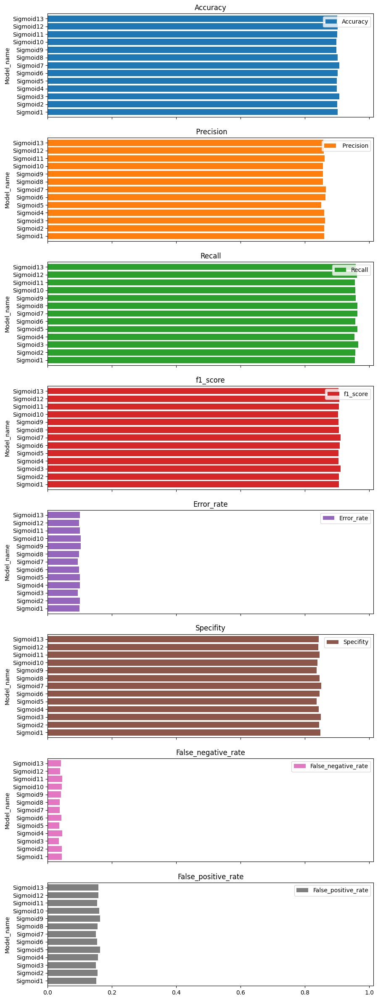

In [87]:
# Uncomment to plot
'''
df_Sigmoid.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

#### Relu Model's Comparations 

In [31]:
# Define weights for Sigmoid Function
L1_relu1,L2_relu1=weigths2(Model_RelU_1)
L1_relu2,L2_relu2=weigths2(Model_RelU_2)
L1_relu3,L2_relu3=weigths2(Model_RelU_3)
L1_relu4,L2_relu4=weigths2(Model_RelU_4)
L1_relu5,L2_relu5=weigths2(Model_RelU_5)
L1_relu6,L2_relu6=weigths2(Model_RelU_6)
L1_relu7,L2_relu7=weigths2(Model_RelU_7)
L1_relu8,L2_relu8=weigths2(Model_RelU_8)
L1_relu9,L2_relu9=weigths2(Model_RelU_9)
L1_relu10,L2_relu10=weigths2(Model_RelU_10)
L1_relu11,L2_relu11=weigths2(Model_RelU_11)
L1_relu12,L2_relu12=weigths2(Model_RelU_12)

binary_relu1 = BinaryNeuralNetwork(L1_relu1,L2_relu1)
binary_relu2 = BinaryNeuralNetwork(L1_relu2,L2_relu2)
binary_relu3 = BinaryNeuralNetwork(L1_relu3,L2_relu3)
binary_relu4 = BinaryNeuralNetwork(L1_relu4,L2_relu4)
binary_relu5 = BinaryNeuralNetwork(L1_relu5,L2_relu5)
binary_relu6 = BinaryNeuralNetwork(L1_relu6,L2_relu6)
binary_relu7 = BinaryNeuralNetwork(L1_relu7,L2_relu7)
binary_relu8 = BinaryNeuralNetwork(L1_relu8,L2_relu8)
binary_relu9 = BinaryNeuralNetwork(L1_relu9,L2_relu9)
binary_relu10 = BinaryNeuralNetwork(L1_relu10,L2_relu10)
binary_relu11 = BinaryNeuralNetwork(L1_relu11,L2_relu11)
binary_relu12 = BinaryNeuralNetwork(L1_relu12,L2_relu12)

In [32]:
# Only run to save new data 
# First run, Uncomment and run one by one!  
with torch.no_grad():
    prediction_loader = test_batch
    #test_preds_Relu1, test_labels_Relu1 = get_all_preds(binary_relu1, prediction_loader)
    #test_preds_Relu2, test_labels_Relu2 = get_all_preds(binary_relu2, prediction_loader)
    #test_preds_Relu3, test_labels_Relu3 = get_all_preds(binary_relu3, prediction_loader)
    #test_preds_Relu4, test_labels_Relu4 = get_all_preds(binary_relu4, prediction_loader)
    #test_preds_Relu5, test_labels_Relu5 = get_all_preds(binary_relu5, prediction_loader)
    #test_preds_Relu6, test_labels_Relu6 = get_all_preds(binary_relu6, prediction_loader)
    #test_preds_Relu7, test_labels_Relu7 = get_all_preds(binary_relu7, prediction_loader)
    #test_preds_Relu8, test_labels_Relu8 = get_all_preds(binary_relu8, prediction_loader)
    #test_preds_Relu9, test_labels_Relu9 = get_all_preds(binary_relu9, prediction_loader)
    #test_preds_Relu10, test_labels_Relu10 = get_all_preds(binary_relu10, prediction_loader)
    #test_preds_Relu11, test_labels_Relu11 = get_all_preds(binary_relu11, prediction_loader)
    test_preds_Relu12, test_labels_Relu12 = get_all_preds(binary_relu12, prediction_loader)

tensor([[ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1., -1.,  1.,
        -1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1.,  1., -1.,
        -1., -1.,  1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1.,  1., -1.,
         1., -1., -1.,  1.,  1.,  1., -1., -1.,  1.,  1.,  1., -1., -1.,  1.,
        -1.,  1., -1., -1.,  1., -1., -1.,  1.,  1., -1.,  1., -1., -1., -1.,
         1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1., -1.,  1.,
        -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1.,
        -1., -1.,  1., -1.,  1.,  1.])
tensor([[ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.

In [ ]:
#Uncomment
#Relu12_metrics= Metrics('Relu12',test_preds_Relu12, test_labels_Relu12)
#print(Relu12_metrics)
#with open("Relu12", "rb") as f:
#    obj = pickle.load(f)
#print(obj)

In [136]:
# From here uncomment when you save 13 models to test performance
#df_Relu = pd.DataFrame.from_records(costr_list('Relu'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

In [137]:
#df_Relu

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Model_name,,,,,,,,
Relu1,0.689495,0.468104,0.948935,0.626942,0.310505,0.591112,0.051065,0.408888
Relu2,0.694040,0.469218,0.941395,0.626280,0.305960,0.601471,0.058605,0.398529
Relu3,0.691414,0.475032,0.941007,0.631350,0.308586,0.593961,0.058993,0.406039
Relu4,0.683737,0.466751,0.940601,0.623904,0.316263,0.584396,0.059399,0.415604
Relu5,0.689495,0.471314,0.941262,0.628115,0.310505,0.592271,0.058738,0.407729
Relu6,0.696162,0.484915,0.938776,0.639501,0.303838,0.598470,0.061224,0.401530
Relu7,0.690303,0.470930,0.943918,0.628364,0.309697,0.592955,0.056082,0.407045
Relu8,0.694949,0.478349,0.936422,0.633228,0.305051,0.600478,0.063578,0.399522
Relu9,0.695960,0.480387,0.942039,0.636298,0.304040,0.599156,0.057961,0.400844


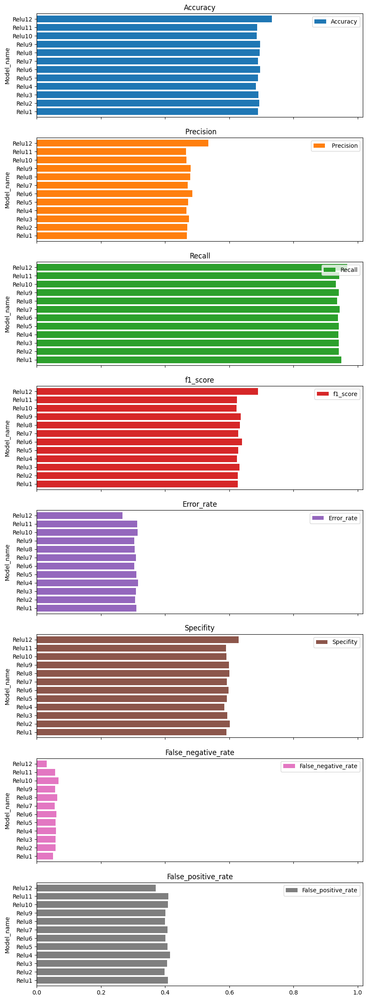

In [138]:
# Uncomment to plot
'''df_Relu.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

#### Tahn Model's Comparations 

In [34]:
# Define weights for Sigmoid Function
L1_tanh1,L2_tanh1=weigths2(Model_Tanh_1)
L1_tanh2,L2_tanh2=weigths2(Model_Tanh_2)
L1_tanh3,L2_tanh3=weigths2(Model_Tanh_3)
L1_tanh4,L2_tanh4=weigths2(Model_Tanh_4)
L1_tanh5,L2_tanh5=weigths2(Model_Tanh_5)
L1_tanh6,L2_tanh6=weigths2(Model_Tanh_6)
L1_tanh7,L2_tanh7=weigths2(Model_Tanh_7)
L1_tanh8,L2_tanh8=weigths2(Model_Tanh_8)
L1_tanh9,L2_tanh9=weigths2(Model_Tanh_9)
L1_tanh10,L2_tanh10=weigths2(Model_Tanh_10)
L1_tanh11,L2_tanh11=weigths2(Model_Tanh_11)
L1_tanh12,L2_tanh12=weigths2(Model_Tanh_12)

binary_tanh1 = BinaryNeuralNetwork(L1_tanh1,L2_tanh1)
binary_tanh2 = BinaryNeuralNetwork(L1_tanh2,L2_tanh2)
binary_tanh3 = BinaryNeuralNetwork(L1_tanh3,L2_tanh3)
binary_tanh4 = BinaryNeuralNetwork(L1_tanh4,L2_tanh4)
binary_tanh5 = BinaryNeuralNetwork(L1_tanh5,L2_tanh5)
binary_tanh6 = BinaryNeuralNetwork(L1_tanh6,L2_tanh6)
binary_tanh7 = BinaryNeuralNetwork(L1_tanh7,L2_tanh7)
binary_tanh8 = BinaryNeuralNetwork(L1_tanh8,L2_tanh8)
binary_tanh9 = BinaryNeuralNetwork(L1_tanh9,L2_tanh9)
binary_tanh10 = BinaryNeuralNetwork(L1_tanh10,L2_tanh10)
binary_tanh11 = BinaryNeuralNetwork(L1_tanh11,L2_tanh11)
binary_tanh12 = BinaryNeuralNetwork(L1_tanh12,L2_tanh12)

In [35]:
# Only run to save new data 
# First run, Uncomment and run one by one!  
with torch.no_grad():
    prediction_loader = test_batch
    test_preds_Tanh1, test_labels_Tanh1 = get_all_preds(binary_tanh1, prediction_loader)
    #test_preds_Tanh2, test_labels_Tanh2 = get_all_preds(binary_tanh2, prediction_loader)
    #test_preds_Tanh3, test_labels_Tanh3 = get_all_preds(binary_tanh3, prediction_loader)
    #test_preds_Tanh4, test_labels_Tanh4 = get_all_preds(binary_tanh4, prediction_loader)
    #test_preds_Tanh5, test_labels_Tanh5 = get_all_preds(binary_tanh5, prediction_loader)
    #test_preds_Tanh6, test_labels_Tanh6 = get_all_preds(binary_tanh6, prediction_loader)
    #test_preds_Tanh7, test_labels_Tanh7 = get_all_preds(binary_tanh7, prediction_loader)
    #test_preds_Tanh8, test_labels_Tanh8 = get_all_preds(binary_tanh8, prediction_loader)
    #test_preds_Tanh9, test_labels_Tanh9 = get_all_preds(binary_tanh9, prediction_loader)
    #test_preds_Tanh10, test_labels_Tanh10 = get_all_preds(binary_tanh10, prediction_loader)
    #test_preds_Tanh11, test_labels_Tanh11 = get_all_preds(binary_tanh11, prediction_loader)
    #test_preds_Tanh12, test_labels_Tanh12 = get_all_preds(binary_tanh12, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1., -1.,
        -1.,  1.,  1.,  1.,  1., -1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,  1.,
         1., -1.,  1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1.,
         1., -1., -1., -1.,  1., -1., -1., -1.,  1., -1., -1., -1.,  1.,  1.,
         1., -1., -1., -1.,  1.,  1., -1., -1., -1.,  1., -1.,  1.,  1., -1.,
        -1.,  1., -1.,  1.,  1., -1.,  1.,  1., -1., -1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1.,  1.,  1., -1.,  1.,
        -1.,  1., -1.,  1., -1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.

In [ ]:
# Uncomment
#Tanh5_metrics= Metrics('Tanh5',test_preds_Tanh5, test_labels_Tanh5)
#print(Tanh5_metrics)
#with open("Tanh5", "rb") as f:
#    obj = pickle.load(f)
#print(obj)

In [129]:
# From here uncomment when you save 13 models to test performance
#df_Tanh = pd.DataFrame.from_records(costr_list('Tanh'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

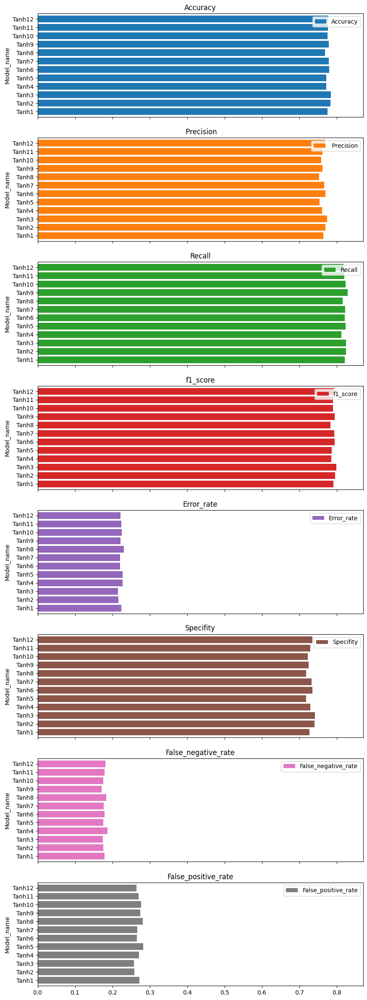

In [130]:
# Uncomment to plot
'''df_Tanh.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

In [36]:
df_mejores = pd.DataFrame(columns=['Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index=['Sigmoid', 'Relu', 'Tanh'])
df_mejores

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Sigmoid,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Relu,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Tanh,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [178]:
#Compare better models 
'''
df_mejores.loc['Sigmoid']=df_Sigmoid.loc['Sigmoid3']
df_mejores.loc['Relu']=df_Relu.loc['Relu12']
df_mejores.loc['Tanh']=df_Tanh.loc['Tanh3']
df_mejores'''

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Sigmoid,0.90697,0.863056,0.965327,0.911331,0.09303,0.84971,0.034673,0.15029
Relu,0.732828,0.535024,0.968306,0.689226,0.267172,0.629021,0.031694,0.370979
Tanh,0.785152,0.774377,0.825034,0.798903,0.214848,0.742415,0.174966,0.257585


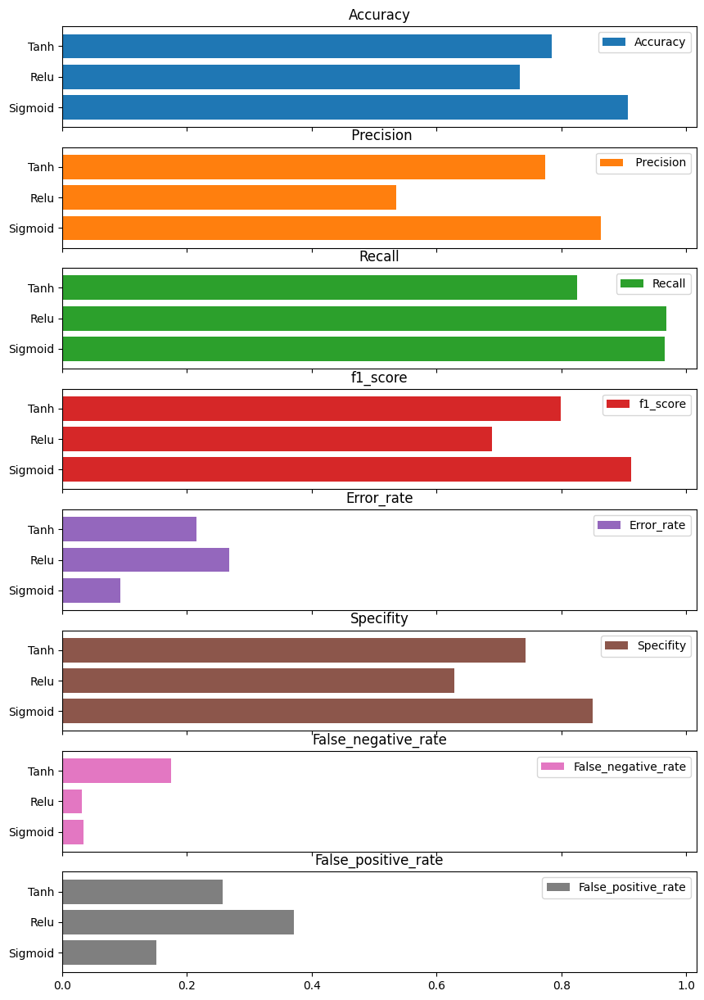

In [182]:
#Uncomment to plot
'''df_mejores.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,15));'''